# Using OpenSTL in your own project

In this notebook, we will provide a comprehensive guide on how to use OpenSTL for your own project. 

Firstly, we will process video data into `.npy` format for easier storage and access. Next, we will demonstrate how to utilize custom data within OpenSTL. Subsequently, we will use OpenSTL to train and evaluate models. Finally, we will visualize predicted frames and generate `.gif` images or videos. 

- [1. Preprocess your data](#1-process-your-data)
    - [1.1 Save the dataset](#11-save-the-dataset)
    - [1.2 Load the dataset and visualize an example](#12-load-the-dataset-and-visualize-an-example)

- [2. Utilize cumtom data](#2-utilize-cumtom-data)
    - [2.1 Define the dataset](#21-define-the-dataset)
    - [2.2 Get the dataloaders](#22-get-the-dataloaders)

- [3. Train and evaluate](#3-train-and-evaluate)
    - [3.1 Define the custom configs](#31-define-the-custom-configs)
    - [3.2 Setup the experiment](#32-setup-the-experiment)
    - [3.3 Start training and evaluation](#33)

- [4. Visualization](#4-visualization)
    - [4.1 Visualize in a line](#41-visualize-in-a-line)
    - [4.2 Generate a GIF](#42-generate-a-gif)

Here we go!

## 1. Process your data

Assume you possess a collection of videos and have already sorted them into the `train/`, `val/`, and `test/` directories. The subsequent step involves transforming these videos into a `.pkl` file for further manipulations.

The existing file hierarchy is as follows:

- custom_usage.ipynb
- train
  - train_example1.avi
  - train_example2.avi
- val
  - val_example1.avi
  - val_example2.avi
- test
  - test_example.avi

It's crucial to note that the above example represents a simplified scenario where we've used `.avi` videos for illustrative purposes. However, in a real-world application, you are free to employ videos in various other formats.

We utilize several videos from the KTH dataset as examples. Although the original KTH dataset consists of single-channel grayscale videos, we save them as three-channel RGB videos to accommodate a broader range of use cases.

### 1.1 Save the dataset

Here, we default to uniformly sampling several frames from the given video data. The number of observed frames and future frames are two hyperparameters (`pre_seq_length`, `aft_seq_length`) that are set in advance. You can also choose to sample the video in other ways and save the data.

#### hyperparameters

`pre_seq_length`: the number of given frames

`aft_seq_length`: the number of frames to predict

In [1]:
pre_seq_length = 10
aft_seq_length = 20

In [2]:
import cv2
import numpy as np
import os

def sample_frames(video_path, num_frames=20):
    # read the video
    video = cv2.VideoCapture(video_path)
    total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    # uniformly sample frames from the video
    frame_idxs = np.linspace(0, total_frames-1, num_frames, dtype=int)
    frames = []
    for idx in frame_idxs:
        video.set(cv2.CAP_PROP_POS_FRAMES, idx)
        _, frame = video.read()
        # frame = cv2.resize(frame, (height, width))
        frames.append(frame)
    video.release()
    return np.stack(frames)

def process_folder(folder_path, pre_slen=10, aft_slen=10, suffix='.avi'):
    # get all the videos in this folder
    videos = []
    files = os.listdir(folder_path)
    for file in files:
        video_path = os.path.join(folder_path, file)
        if os.path.isfile(video_path) and file.endswith(suffix):
            video = sample_frames(video_path, pre_slen + aft_slen)
            videos.append(video)
    # stack video frames from each folder
    data = np.stack(videos).transpose(0, 1, 4, 2, 3)

    # if the data is in [0, 255], rescale it into [0, 1]
    if data.max() > 1.0:
        data = data.astype(np.float32) / 255.0

    return data[:, :pre_slen], data[:, pre_slen:]

In [3]:
# import pickle

# dataset = {}
# folders = ['train', 'val', 'test']
# for folder in folders:
#     data_x, data_y = process_folder(folder, pre_slen=pre_seq_length, aft_slen=aft_seq_length, suffix='.avi')
#     dataset['X_' + folder], dataset['Y_' + folder] = data_x, data_y

# # save as a pkl file
# with open('dataset.pkl', 'wb') as f:
#     pickle.dump(dataset, f)

### 1.2 Load the dataset and visualize an example

In [4]:
import pickle

# load the dataset
# with open('dataset.pkl', 'rb') as f:
with open('./reformatedNDDs/dataset.pkl', 'rb') as f:
    dataset = pickle.load(f)

train_x, train_y = dataset['X_train'], dataset['Y_train']
print(f"X_train: {dataset['X_train'].shape}")
print(f"Y_train: {dataset['Y_train'].shape}")
print(f"X_test: {dataset['X_test'].shape}")
print(f"Y_test: {dataset['Y_test'].shape}")
print(f"X_val: {dataset['X_val'].shape}")
print(f"Y_val: {dataset['Y_val'].shape}")

# the shape is B x T x C x H x W
# B: the number of samples
# T: the number of frames in each sample
# C, H, W: the channel, height, width of each frame

X_train: (65, 10, 1, 160, 280)
Y_train: (65, 20, 1, 160, 280)
X_test: (15, 10, 1, 160, 280)
Y_test: (15, 20, 1, 160, 280)
X_val: (13, 10, 1, 160, 280)
Y_val: (13, 20, 1, 160, 280)


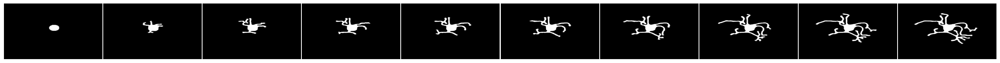

In [5]:
from openstl.utils import show_video_line

# show the given frames from an example
example_idx = np.random.randint(0, len(train_x))
show_video_line(train_x[example_idx], ncols=pre_seq_length, vmax=0.6, cbar=False, out_path=None, format='png', use_rgb=False)

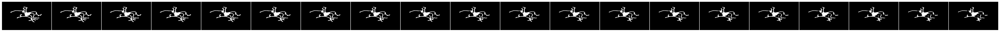

In [6]:
# show the future frames from an example
show_video_line(train_y[example_idx], ncols=aft_seq_length, vmax=0.6, cbar=False, out_path=None, format='png', use_rgb=False)

## 2. Utilize cumtom data

### 2.1 Define the dataset

We first define the `CustomDataset` to use the provided dataset. 

For real video prediction, to facilitate model optimization, we strongly recommend users to use frames represented as `float32` with values in the range of $[0, 1]$, rather than frames represented as `uint8` with values in the range of $[0, 255]$. For other types of data, we also provide the option to `normalize` in the `CustomDataset`.

In [7]:
import torch
from torch.utils.data import Dataset


class CustomDataset(Dataset):
    def __init__(self, X, Y, normalize=False, data_name='custom'):
        super(CustomDataset, self).__init__()
        self.X = X
        self.Y = Y
        self.mean = None
        self.std = None
        self.data_name = data_name

        if normalize:
            # get the mean/std values along the channel dimension
            mean = data.mean(axis=(0, 1, 2, 3)).reshape(1, 1, -1, 1, 1)
            std = data.std(axis=(0, 1, 2, 3)).reshape(1, 1, -1, 1, 1)
            data = (data - mean) / std
            self.mean = mean
            self.std = std

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, index):
        data = torch.tensor(self.X[index]).float()
        labels = torch.tensor(self.Y[index]).float()
        return data, labels

### 2.2 Get the dataloaders

Now we can get the dataloaders by using the collected dataset and the defined `CustomDataset`.

#### hyperparameters

`batch_size`: the size of a batch

In [8]:
batch_size = 5

In [9]:
X_train, X_val, X_test, Y_train, Y_val, Y_test = dataset['X_train'], dataset[
    'X_val'], dataset['X_test'], dataset['Y_train'], dataset['Y_val'], dataset['Y_test']

train_set = CustomDataset(X=X_train, Y=Y_train)
val_set = CustomDataset(X=X_val, Y=Y_val)
test_set = CustomDataset(X=X_test, Y=Y_test)

In [10]:
dataloader_train = torch.utils.data.DataLoader(
    train_set, batch_size=batch_size, shuffle=True, pin_memory=True)
dataloader_val = torch.utils.data.DataLoader(
    val_set, batch_size=batch_size, shuffle=True, pin_memory=True)
dataloader_test = torch.utils.data.DataLoader(
    test_set, batch_size=batch_size, shuffle=True, pin_memory=True)

## 3. Train and evaluate

### 3.1 Define the custom configs

We first define the training configuration, which includes several important hyperparameters for training.

Here, we set `epoch = 3` as an example for simple training. The actual value of epoch in your project depends on the complexity of your dataset. Generally, a good starting point is `epoch = 100`.

Next, we define the model configuration to customize a spatio-temporal predictive learning model. For MetaVP models, the key hyperparameters are: `N_S`, `N_T`, `hid_S`, `hid_T`, and `model_type`. Users have the option to either use a config file or directly set these hyperparameters.

If a config file is preferred, the user can simply include a `config_file` key with the path to the config file in the `custom_model_config` below. Otherwise, the user can directly specify these hyperparameters in the `custom_model_config`.

In [11]:
custom_training_config = {
    'pre_seq_length': pre_seq_length,
    'aft_seq_length': aft_seq_length,
    'total_length': pre_seq_length + aft_seq_length,
    'batch_size': batch_size,
    'val_batch_size': batch_size,
    'epoch': 100,
    'lr': 0.001,   
    'metrics': ['mse', 'mae'],

    'ex_name': 'custom_exp',
    'dataname': 'custom',
    'in_shape': [10, 1, 32, 32],
}

custom_model_config = {
    # For MetaVP models, the most important hyperparameters are: 
    # N_S, N_T, hid_S, hid_T, model_type
    # 'method': 'Modified_SimVP',
    'method': 'SimVP',
    # Users can either using a config file or directly set these hyperparameters 
    # 'config_file': 'configs/custom/example_model.py',
    
    # Here, we directly set these parameters
    'model_type': 'gSTA',
    'N_S': 4,
    'N_T': 8,
    'hid_S': 64,
    'hid_T': 256
}

### 3.2 Setup the experiment

We retrieve the default hyperparameters by utilizing `create_parser` and update those hyperparameters that are defined in `custom_training_config` and `custom_model_config`. 

By utilizing `BaseExperiment`, we ensure that everything is prepared, including dataloader setup and model initialization.

In [12]:
from openstl.api import BaseExperiment
from openstl.utils import create_parser, default_parser

args = create_parser().parse_args([])
config = args.__dict__

# update the training config
config.update(custom_training_config)
# update the model config
config.update(custom_model_config)
# fulfill with default values
default_values = default_parser()
for attribute in default_values.keys():
    if config[attribute] is None:
        config[attribute] = default_values[attribute]

exp = BaseExperiment(args, dataloaders=(dataloader_train, dataloader_val, dataloader_test), strategy='auto')

[rank: 0] Seed set to 42
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


### 3.3 Start training and evaluation

With everything in place, we are now ready to start training and evaluation. 

Here we go!

In [13]:
torch.set_float32_matmul_precision('high')

print('>'*35 + ' training ' + '<'*35)
exp.train()

print('>'*35 + ' testing  ' + '<'*35)
exp.test()

>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> training <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/bin/sh: /usr/local/cuda/bin/nvcc: No such file or directory

  | Name      | Type        | Params
------------------------------------------
0 | model     | SimVP_Model | 18.6 M
1 | criterion | MSELoss     | 0     
------------------------------------------
18.6 M    Trainable params
0         Non-trainable params
18.6 M    Total params
74.412    Total estimated model params size (MB)


Environment info:
------------------------------------------------------------
sys.platform: linux
Python: 3.9.0 (default, Nov 15 2020, 14:28:56) [GCC 7.3.0]
CUDA available: True
CUDA_HOME: /usr/local/cuda
NVCC: 
GPU 0: Tesla V100-SXM2-32GB
GCC: gcc (GCC) 8.5.0 20210514 (Red Hat 8.5.0-18)
PyTorch: 2.1.0+cu121
PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX512
  - CUDA Runtime 12.1
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code=sm_80;-gencode;arch=compute_86,code=sm_8

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 0, global step 13: 'val_loss' reached 0.03423 (best 0.03423), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=00-val_loss=0.034.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 1: Lr: 0.0000505 | Train Loss: 0.0664204 | Vali Loss: 0.0233380


Epoch 1, global step 26: 'val_loss' reached 0.02334 (best 0.02334), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=01-val_loss=0.023.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 2: Lr: 0.0000636 | Train Loss: 0.0264656 | Vali Loss: 0.0153852


Epoch 2, global step 39: 'val_loss' reached 0.01539 (best 0.01539), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=02-val_loss=0.015.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 3: Lr: 0.0000817 | Train Loss: 0.0178361 | Vali Loss: 0.0118353


Epoch 3, global step 52: 'val_loss' reached 0.01184 (best 0.01184), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=03-val_loss=0.012.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 4: Lr: 0.0001046 | Train Loss: 0.0136824 | Vali Loss: 0.0104406


Epoch 4, global step 65: 'val_loss' reached 0.01044 (best 0.01044), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=04-val_loss=0.010.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 5: Lr: 0.0001321 | Train Loss: 0.0113331 | Vali Loss: 0.0095194


Epoch 5, global step 78: 'val_loss' reached 0.00952 (best 0.00952), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=05-val_loss=0.010.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 6: Lr: 0.0001639 | Train Loss: 0.0100773 | Vali Loss: 0.0085178


Epoch 6, global step 91: 'val_loss' reached 0.00852 (best 0.00852), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=06-val_loss=0.009.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 7: Lr: 0.0001996 | Train Loss: 0.0091363 | Vali Loss: 0.0076458


Epoch 7, global step 104: 'val_loss' reached 0.00765 (best 0.00765), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=07-val_loss=0.008.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 8: Lr: 0.0002388 | Train Loss: 0.0081538 | Vali Loss: 0.0067352


Epoch 8, global step 117: 'val_loss' reached 0.00674 (best 0.00674), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=08-val_loss=0.007.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 9: Lr: 0.0002811 | Train Loss: 0.0072608 | Vali Loss: 0.0057662


Epoch 9, global step 130: 'val_loss' reached 0.00577 (best 0.00577), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=09-val_loss=0.006.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 10: Lr: 0.0003261 | Train Loss: 0.0063039 | Vali Loss: 0.0050188


Epoch 10, global step 143: 'val_loss' reached 0.00502 (best 0.00502), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=10-val_loss=0.005.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 11: Lr: 0.0003731 | Train Loss: 0.0054503 | Vali Loss: 0.0044682


Epoch 11, global step 156: 'val_loss' reached 0.00447 (best 0.00447), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=11-val_loss=0.004.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 12: Lr: 0.0004218 | Train Loss: 0.0047821 | Vali Loss: 0.0039900


Epoch 12, global step 169: 'val_loss' reached 0.00399 (best 0.00399), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=12-val_loss=0.004.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 13: Lr: 0.0004716 | Train Loss: 0.0043443 | Vali Loss: 0.0035589


Epoch 13, global step 182: 'val_loss' reached 0.00356 (best 0.00356), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=13-val_loss=0.004.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 14: Lr: 0.0005219 | Train Loss: 0.0038357 | Vali Loss: 0.0037149


Epoch 14, global step 195: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 15: Lr: 0.0005722 | Train Loss: 0.0036632 | Vali Loss: 0.0032237


Epoch 15, global step 208: 'val_loss' reached 0.00322 (best 0.00322), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=15-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 16: Lr: 0.0006219 | Train Loss: 0.0030705 | Vali Loss: 0.0029319


Epoch 16, global step 221: 'val_loss' reached 0.00293 (best 0.00293), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=16-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 17: Lr: 0.0006705 | Train Loss: 0.0026210 | Vali Loss: 0.0030221


Epoch 17, global step 234: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 18: Lr: 0.0007175 | Train Loss: 0.0023899 | Vali Loss: 0.0034901


Epoch 18, global step 247: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 19: Lr: 0.0007622 | Train Loss: 0.0022941 | Vali Loss: 0.0028726


Epoch 19, global step 260: 'val_loss' reached 0.00287 (best 0.00287), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=19-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 20: Lr: 0.0008043 | Train Loss: 0.0022116 | Vali Loss: 0.0027025


Epoch 20, global step 273: 'val_loss' reached 0.00270 (best 0.00270), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=20-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 21: Lr: 0.0008433 | Train Loss: 0.0017393 | Vali Loss: 0.0026340


Epoch 21, global step 286: 'val_loss' reached 0.00263 (best 0.00263), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=21-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 22: Lr: 0.0008787 | Train Loss: 0.0015754 | Vali Loss: 0.0027082


Epoch 22, global step 299: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 23: Lr: 0.0009101 | Train Loss: 0.0014128 | Vali Loss: 0.0025063


Epoch 23, global step 312: 'val_loss' reached 0.00251 (best 0.00251), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=23-val_loss=0.003.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 24: Lr: 0.0009373 | Train Loss: 0.0013479 | Vali Loss: 0.0024802


Epoch 24, global step 325: 'val_loss' reached 0.00248 (best 0.00248), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=24-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 25: Lr: 0.0009599 | Train Loss: 0.0011652 | Vali Loss: 0.0024349


Epoch 25, global step 338: 'val_loss' reached 0.00243 (best 0.00243), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=25-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 26: Lr: 0.0009776 | Train Loss: 0.0011302 | Vali Loss: 0.0023912


Epoch 26, global step 351: 'val_loss' reached 0.00239 (best 0.00239), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=26-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 27: Lr: 0.0009902 | Train Loss: 0.0009452 | Vali Loss: 0.0024517


Epoch 27, global step 364: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 28: Lr: 0.0009977 | Train Loss: 0.0009246 | Vali Loss: 0.0024637


Epoch 28, global step 377: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 29: Lr: 0.0010000 | Train Loss: 0.0009559 | Vali Loss: 0.0023143


Epoch 29, global step 390: 'val_loss' reached 0.00231 (best 0.00231), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=29-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 30: Lr: 0.0009994 | Train Loss: 0.0009206 | Vali Loss: 0.0023077


Epoch 30, global step 403: 'val_loss' reached 0.00231 (best 0.00231), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=30-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 31: Lr: 0.0009978 | Train Loss: 0.0009434 | Vali Loss: 0.0026323


Epoch 31, global step 416: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 32: Lr: 0.0009952 | Train Loss: 0.0008067 | Vali Loss: 0.0023203


Epoch 32, global step 429: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 33: Lr: 0.0009917 | Train Loss: 0.0008499 | Vali Loss: 0.0022566


Epoch 33, global step 442: 'val_loss' reached 0.00226 (best 0.00226), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=33-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 34: Lr: 0.0009871 | Train Loss: 0.0007561 | Vali Loss: 0.0023923


Epoch 34, global step 455: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 35: Lr: 0.0009815 | Train Loss: 0.0007385 | Vali Loss: 0.0022550


Epoch 35, global step 468: 'val_loss' reached 0.00225 (best 0.00225), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=35-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 36: Lr: 0.0009750 | Train Loss: 0.0006794 | Vali Loss: 0.0023108


Epoch 36, global step 481: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 37: Lr: 0.0009675 | Train Loss: 0.0006211 | Vali Loss: 0.0023178


Epoch 37, global step 494: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 38: Lr: 0.0009591 | Train Loss: 0.0006647 | Vali Loss: 0.0025420


Epoch 38, global step 507: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 39: Lr: 0.0009497 | Train Loss: 0.0007276 | Vali Loss: 0.0025607


Epoch 39, global step 520: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 40: Lr: 0.0009395 | Train Loss: 0.0006904 | Vali Loss: 0.0022437


Epoch 40, global step 533: 'val_loss' reached 0.00224 (best 0.00224), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=40-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 41: Lr: 0.0009283 | Train Loss: 0.0006006 | Vali Loss: 0.0022918


Epoch 41, global step 546: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 42: Lr: 0.0009163 | Train Loss: 0.0005396 | Vali Loss: 0.0022054


Epoch 42, global step 559: 'val_loss' reached 0.00221 (best 0.00221), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=42-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 43: Lr: 0.0009035 | Train Loss: 0.0005114 | Vali Loss: 0.0022008


Epoch 43, global step 572: 'val_loss' reached 0.00220 (best 0.00220), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=43-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 44: Lr: 0.0008898 | Train Loss: 0.0005098 | Vali Loss: 0.0021777


Epoch 44, global step 585: 'val_loss' reached 0.00218 (best 0.00218), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=44-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 45: Lr: 0.0008754 | Train Loss: 0.0004939 | Vali Loss: 0.0022271


Epoch 45, global step 598: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 46: Lr: 0.0008602 | Train Loss: 0.0004956 | Vali Loss: 0.0021765


Epoch 46, global step 611: 'val_loss' reached 0.00218 (best 0.00218), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=46-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 47: Lr: 0.0008443 | Train Loss: 0.0004387 | Vali Loss: 0.0022577


Epoch 47, global step 624: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 48: Lr: 0.0008277 | Train Loss: 0.0004732 | Vali Loss: 0.0022134


Epoch 48, global step 637: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 49: Lr: 0.0008104 | Train Loss: 0.0004140 | Vali Loss: 0.0021388


Epoch 49, global step 650: 'val_loss' reached 0.00214 (best 0.00214), saving model to '/ocean/projects/eng170006p/ussqww/OpenSTL/examples/work_dirs/custom_exp/checkpoints/best-epoch=49-val_loss=0.002.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 50: Lr: 0.0007925 | Train Loss: 0.0003814 | Vali Loss: 0.0022013


Epoch 50, global step 663: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 51: Lr: 0.0007740 | Train Loss: 0.0003714 | Vali Loss: 0.0021920


Epoch 51, global step 676: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 52: Lr: 0.0007550 | Train Loss: 0.0003687 | Vali Loss: 0.0021757


Epoch 52, global step 689: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 53: Lr: 0.0007354 | Train Loss: 0.0003438 | Vali Loss: 0.0022576


Epoch 53, global step 702: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 54: Lr: 0.0007154 | Train Loss: 0.0003738 | Vali Loss: 0.0022077


Epoch 54, global step 715: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 55: Lr: 0.0006949 | Train Loss: 0.0003842 | Vali Loss: 0.0022243


Epoch 55, global step 728: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 56: Lr: 0.0006741 | Train Loss: 0.0003608 | Vali Loss: 0.0021582


Epoch 56, global step 741: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 57: Lr: 0.0006529 | Train Loss: 0.0003495 | Vali Loss: 0.0021944


Epoch 57, global step 754: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 58: Lr: 0.0006314 | Train Loss: 0.0003281 | Vali Loss: 0.0021535


Epoch 58, global step 767: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 59: Lr: 0.0006096 | Train Loss: 0.0003509 | Vali Loss: 0.0021975


Epoch 59, global step 780: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 60: Lr: 0.0005876 | Train Loss: 0.0003382 | Vali Loss: 0.0021646


Epoch 60, global step 793: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 61: Lr: 0.0005654 | Train Loss: 0.0003575 | Vali Loss: 0.0021597


Epoch 61, global step 806: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 62: Lr: 0.0005431 | Train Loss: 0.0003112 | Vali Loss: 0.0021892


Epoch 62, global step 819: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 63: Lr: 0.0005207 | Train Loss: 0.0002931 | Vali Loss: 0.0021675


Epoch 63, global step 832: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 64: Lr: 0.0004983 | Train Loss: 0.0003143 | Vali Loss: 0.0021496


Epoch 64, global step 845: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 65: Lr: 0.0004758 | Train Loss: 0.0002949 | Vali Loss: 0.0022373


Epoch 65, global step 858: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 66: Lr: 0.0004535 | Train Loss: 0.0003319 | Vali Loss: 0.0021612


Epoch 66, global step 871: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 67: Lr: 0.0004312 | Train Loss: 0.0002990 | Vali Loss: 0.0021819


Epoch 67, global step 884: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 68: Lr: 0.0004090 | Train Loss: 0.0002811 | Vali Loss: 0.0021514


Epoch 68, global step 897: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 69: Lr: 0.0003871 | Train Loss: 0.0002691 | Vali Loss: 0.0021549


Epoch 69, global step 910: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 70: Lr: 0.0003653 | Train Loss: 0.0002754 | Vali Loss: 0.0021718


Epoch 70, global step 923: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 71: Lr: 0.0003439 | Train Loss: 0.0003323 | Vali Loss: 0.0021619


Epoch 71, global step 936: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 72: Lr: 0.0003227 | Train Loss: 0.0002701 | Vali Loss: 0.0021712


Epoch 72, global step 949: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 73: Lr: 0.0003019 | Train Loss: 0.0002589 | Vali Loss: 0.0021643


Epoch 73, global step 962: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 74: Lr: 0.0002815 | Train Loss: 0.0002578 | Vali Loss: 0.0021644


Epoch 74, global step 975: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 75: Lr: 0.0002615 | Train Loss: 0.0002538 | Vali Loss: 0.0021581


Epoch 75, global step 988: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 76: Lr: 0.0002421 | Train Loss: 0.0002561 | Vali Loss: 0.0021785


Epoch 76, global step 1001: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 77: Lr: 0.0002231 | Train Loss: 0.0002549 | Vali Loss: 0.0021660


Epoch 77, global step 1014: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 78: Lr: 0.0002047 | Train Loss: 0.0002638 | Vali Loss: 0.0021656


Epoch 78, global step 1027: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 79: Lr: 0.0001869 | Train Loss: 0.0002550 | Vali Loss: 0.0021597


Epoch 79, global step 1040: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 80: Lr: 0.0001697 | Train Loss: 0.0002440 | Vali Loss: 0.0021649


Epoch 80, global step 1053: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 81: Lr: 0.0001532 | Train Loss: 0.0002523 | Vali Loss: 0.0021756


Epoch 81, global step 1066: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 82: Lr: 0.0001374 | Train Loss: 0.0002601 | Vali Loss: 0.0021596


Epoch 82, global step 1079: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 83: Lr: 0.0001223 | Train Loss: 0.0002409 | Vali Loss: 0.0021558


Epoch 83, global step 1092: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 84: Lr: 0.0001080 | Train Loss: 0.0002494 | Vali Loss: 0.0021639


Epoch 84, global step 1105: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 85: Lr: 0.0000945 | Train Loss: 0.0002464 | Vali Loss: 0.0021588


Epoch 85, global step 1118: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 86: Lr: 0.0000818 | Train Loss: 0.0002423 | Vali Loss: 0.0021616


Epoch 86, global step 1131: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 87: Lr: 0.0000699 | Train Loss: 0.0002422 | Vali Loss: 0.0021626


Epoch 87, global step 1144: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 88: Lr: 0.0000589 | Train Loss: 0.0002399 | Vali Loss: 0.0021594


Epoch 88, global step 1157: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 89: Lr: 0.0000488 | Train Loss: 0.0002359 | Vali Loss: 0.0021597


Epoch 89, global step 1170: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 90: Lr: 0.0000396 | Train Loss: 0.0002439 | Vali Loss: 0.0021592


Epoch 90, global step 1183: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 91: Lr: 0.0000313 | Train Loss: 0.0002416 | Vali Loss: 0.0021668


Epoch 91, global step 1196: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 92: Lr: 0.0000239 | Train Loss: 0.0002664 | Vali Loss: 0.0021571


Epoch 92, global step 1209: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 93: Lr: 0.0000176 | Train Loss: 0.0002833 | Vali Loss: 0.0021670


Epoch 93, global step 1222: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 94: Lr: 0.0000122 | Train Loss: 0.0003154 | Vali Loss: 0.0021617


Epoch 94, global step 1235: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 95: Lr: 0.0000077 | Train Loss: 0.0002352 | Vali Loss: 0.0021567


Epoch 95, global step 1248: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 96: Lr: 0.0000043 | Train Loss: 0.0002380 | Vali Loss: 0.0021597


Epoch 96, global step 1261: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 97: Lr: 0.0000019 | Train Loss: 0.0002362 | Vali Loss: 0.0021590


Epoch 97, global step 1274: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 98: Lr: 0.0000004 | Train Loss: 0.0002386 | Vali Loss: 0.0021601


Epoch 98, global step 1287: 'val_loss' was not in top 1


Validation: |          | 0/? [00:00<?, ?it/s]

Epoch 99: Lr: 0.0000000 | Train Loss: 0.0002683 | Vali Loss: 0.0021602


Epoch 99, global step 1300: 'val_loss' was not in top 1
`Trainer.fit` stopped: `max_epochs=100` reached.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> testing  <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<


Testing: |          | 0/? [00:00<?, ?it/s]

mse:109.50389862060547, mae:440.83258056640625


## Visualization

By employing the `show_video_line` and `show_video_gif_multiple` functions provided by `OpenSTL`, we can visualize the input, ground truth, and predicted frames, as well as generate corresponding GIFs.

### 4.1 Visualize in a line

In [27]:
import numpy as np
from openstl.utils import show_video_line

# Load the inputs, predictions, and true values
inputs = np.load('./work_dirs/custom_exp/saved/inputs.npy')
preds = np.load('./work_dirs/custom_exp/saved/preds.npy')
trues = np.load('./work_dirs/custom_exp/saved/trues.npy')

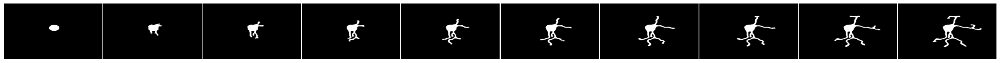

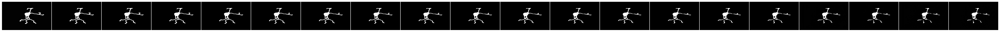

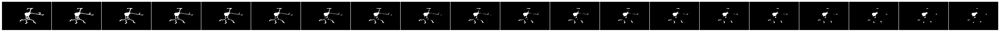

In [28]:
# Generate a random index for the example
example_idx = np.random.randint(0, len(inputs))

# Show the frames for the input, prediction, and ground truth
show_video_line(inputs[example_idx], ncols=10, vmax=0.6, cbar=False, out_path=None, format='png', use_rgb=False)
show_video_line(preds[example_idx], ncols=20, vmax=0.6, cbar=False, out_path=None, format='png', use_rgb=False)
show_video_line(trues[example_idx], ncols=20, vmax=0.6, cbar=False, out_path=None, format='png', use_rgb=False)

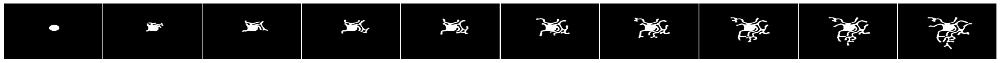

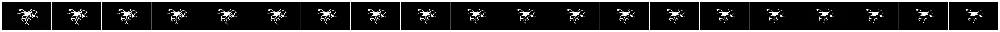

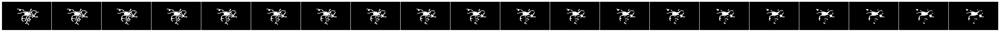

GIF saved as ./prediction_gif/example_0.gif


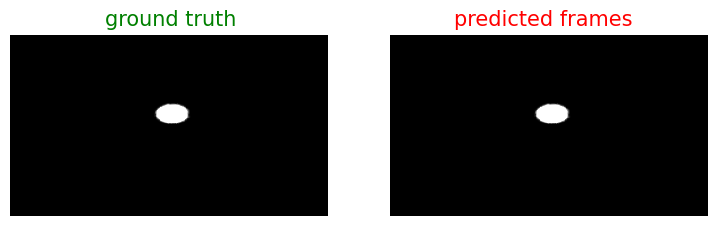

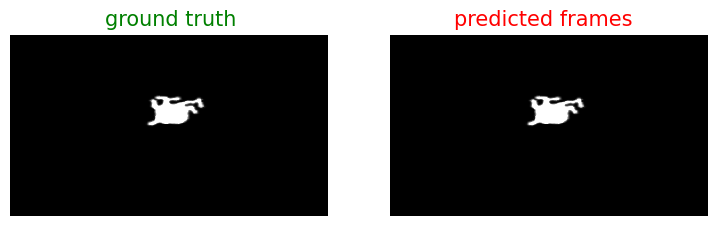

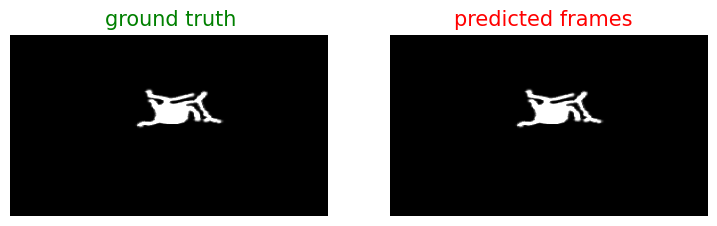

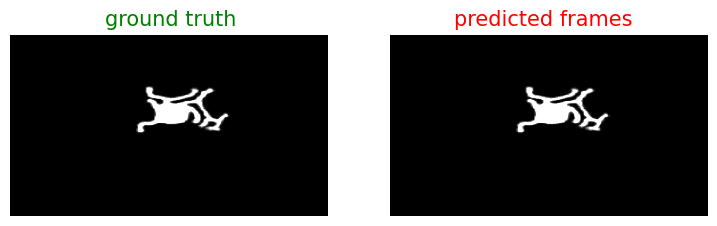

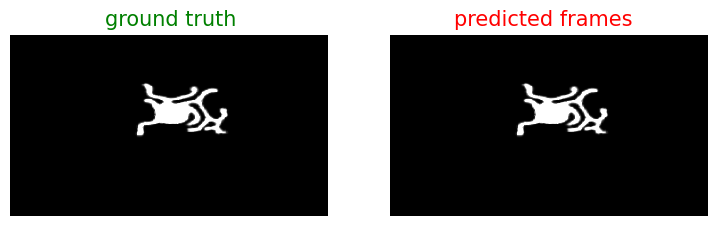

...

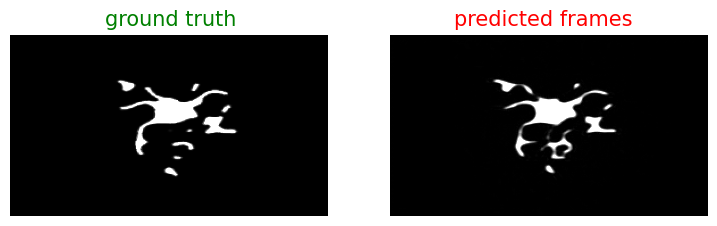

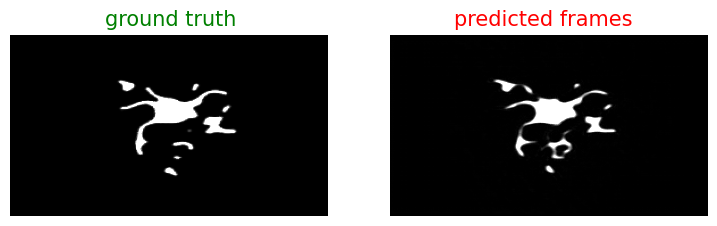

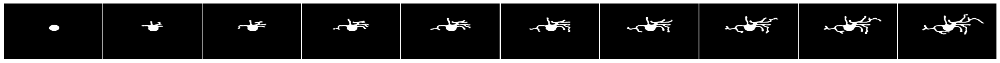

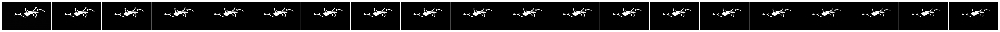

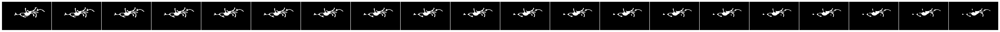

GIF saved as ./prediction_gif/example_1.gif


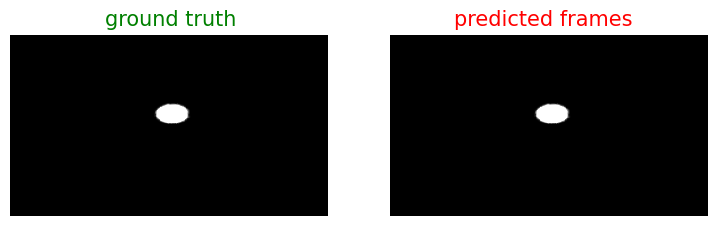

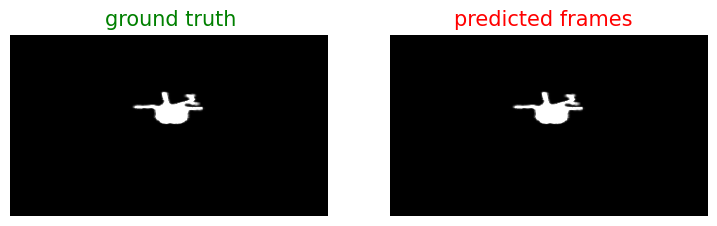

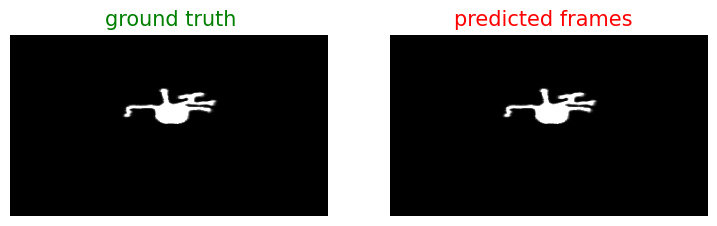

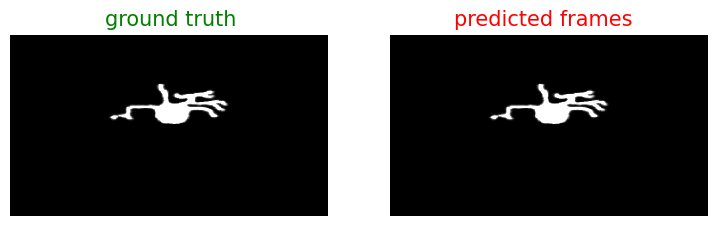

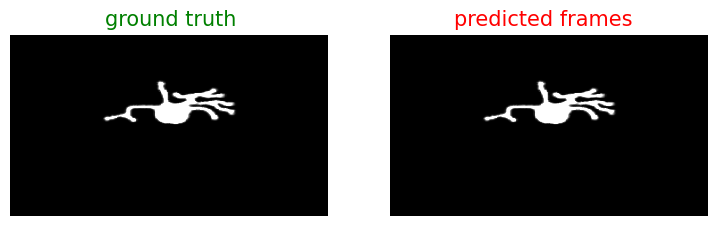

...

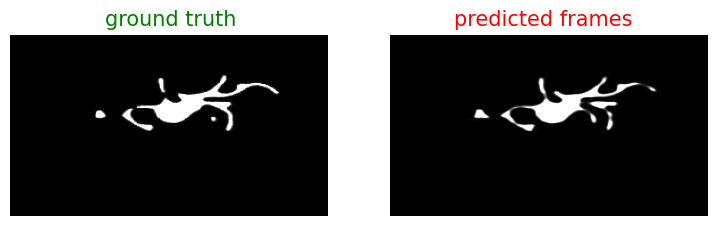

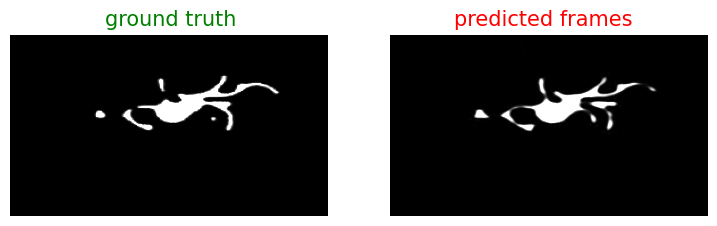

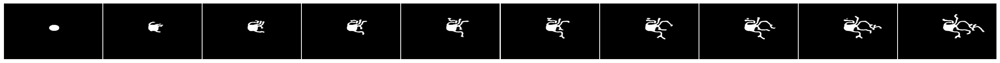

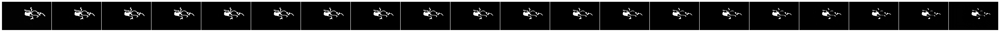

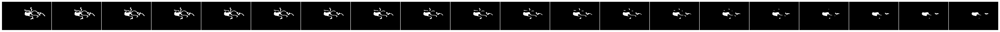

GIF saved as ./prediction_gif/example_2.gif


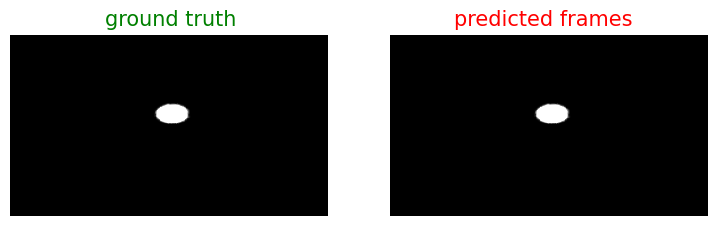

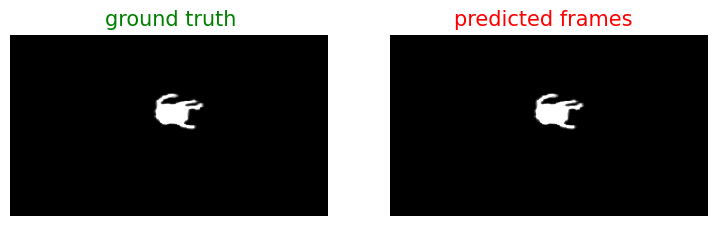

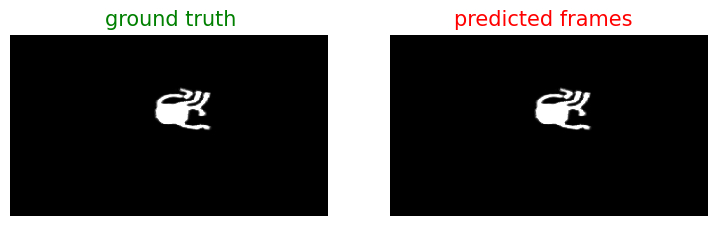

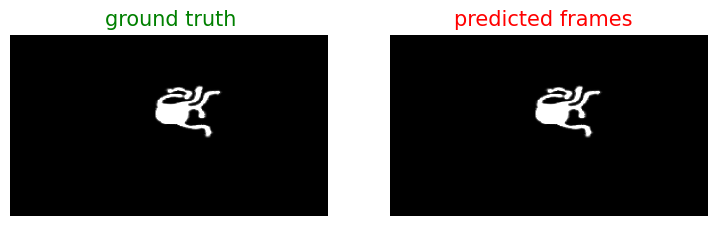

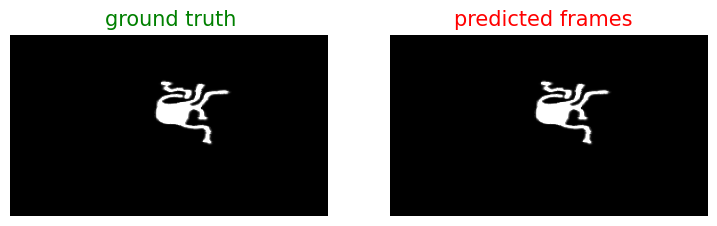

...

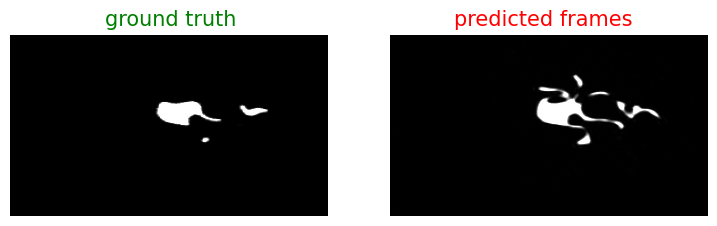

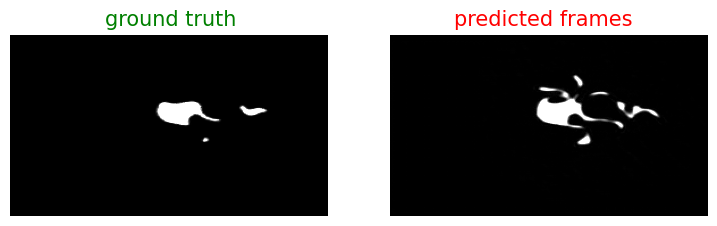

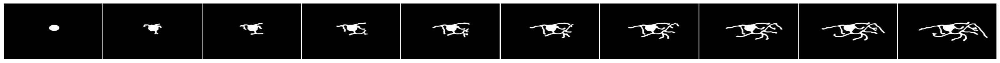

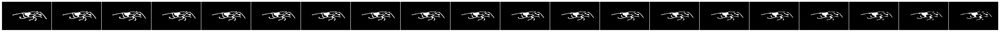

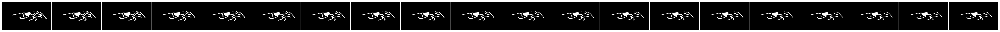

GIF saved as ./prediction_gif/example_3.gif


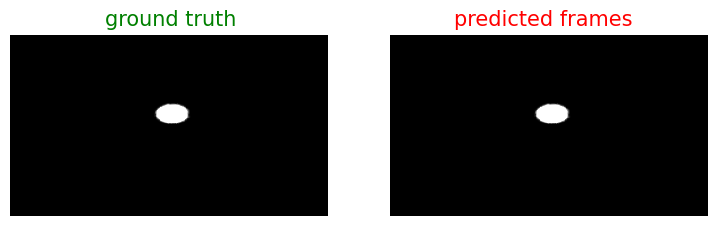

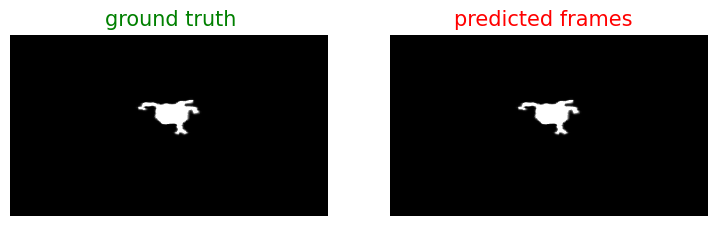

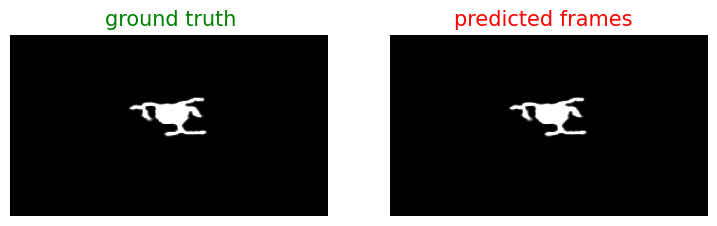

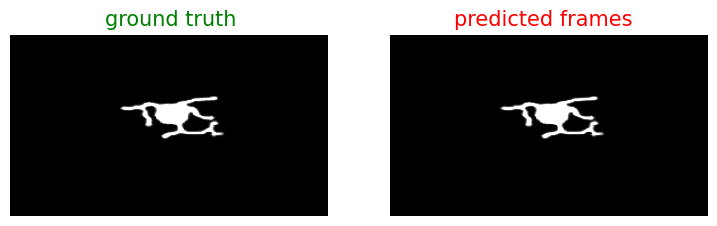

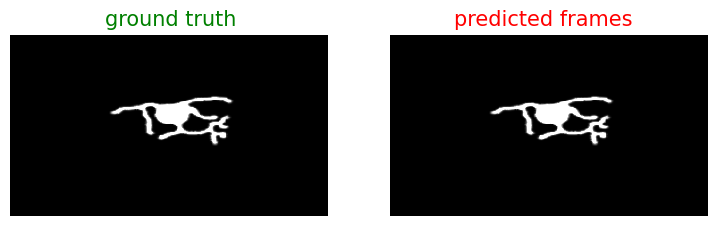

...

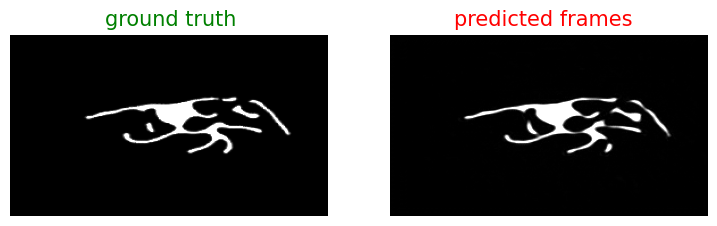

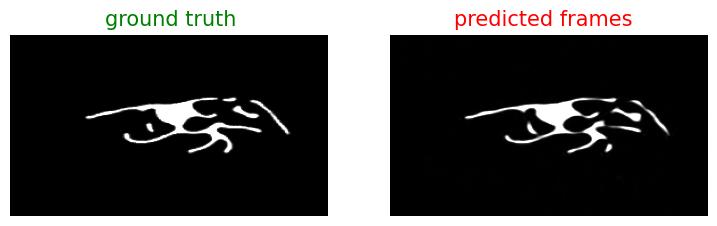

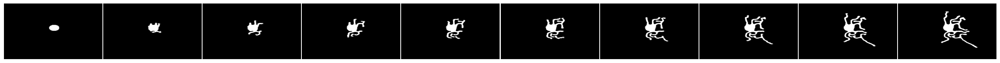

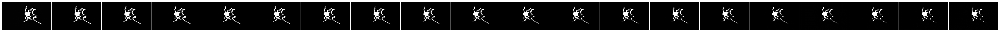

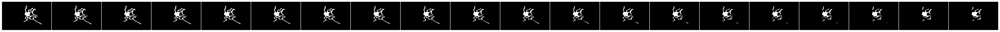

GIF saved as ./prediction_gif/example_4.gif


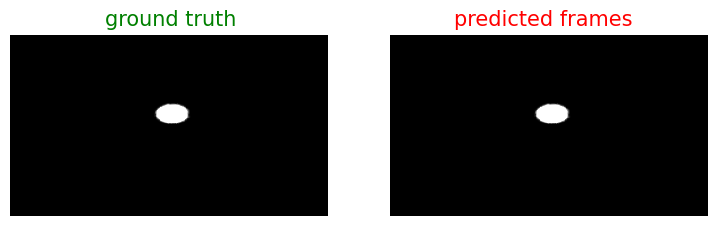

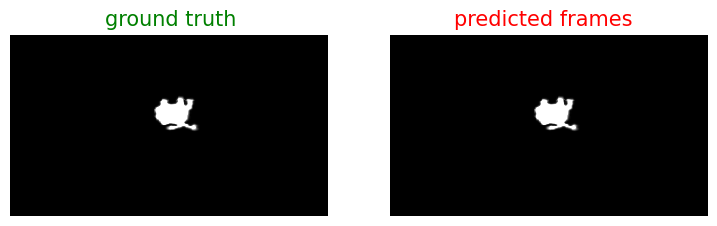

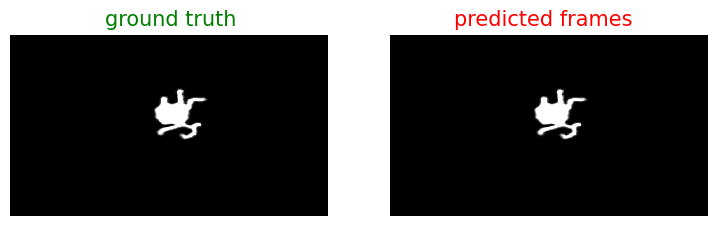

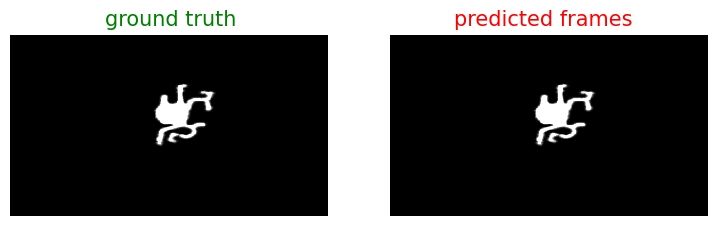

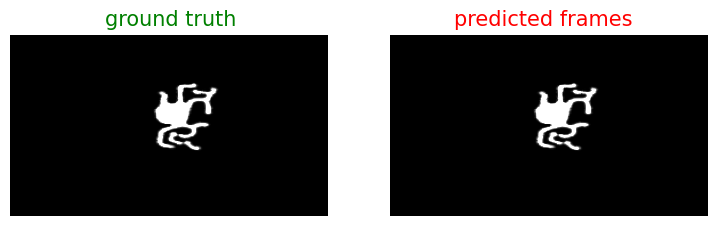

...

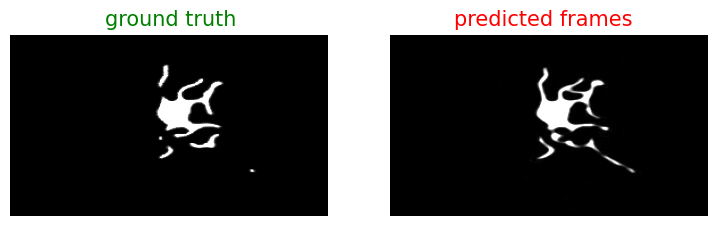

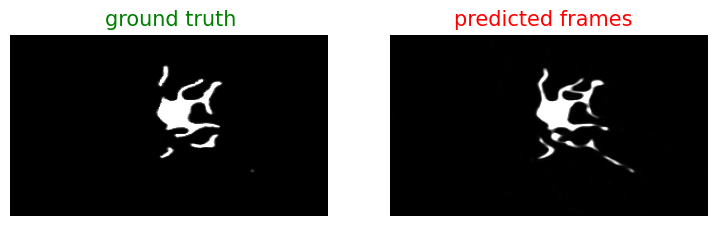

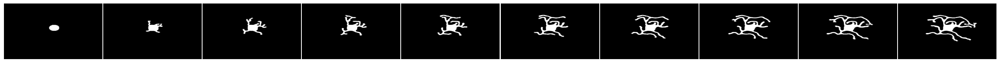

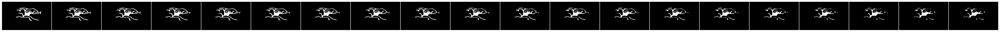

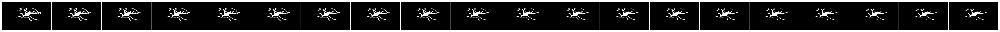

GIF saved as ./prediction_gif/example_5.gif


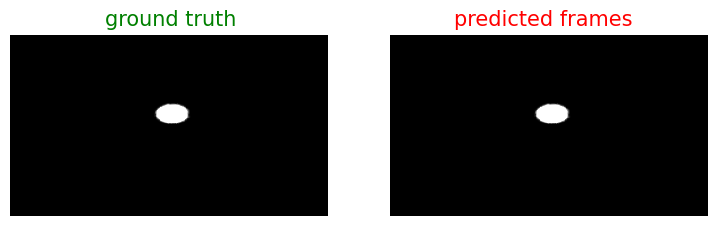

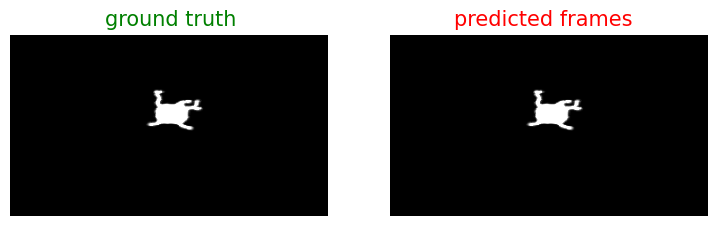

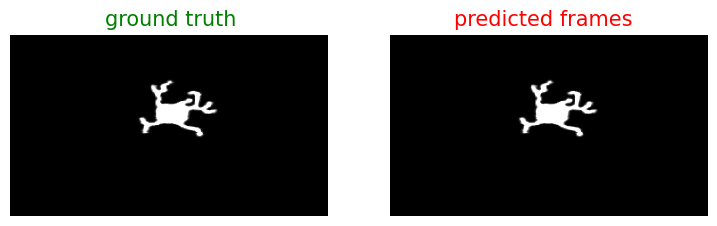

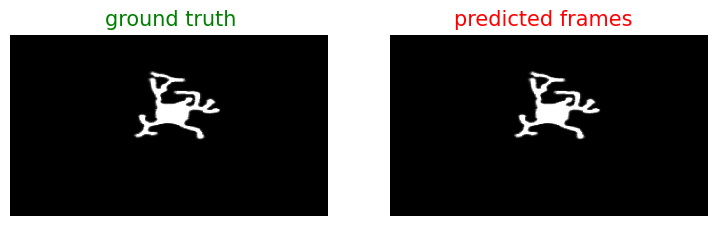

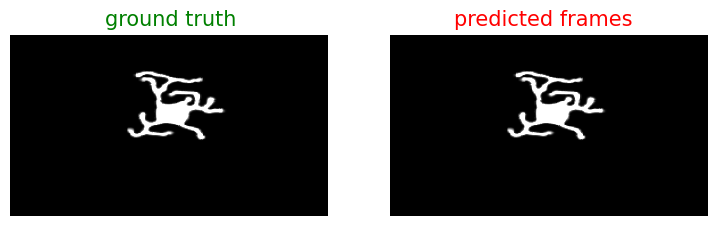

...

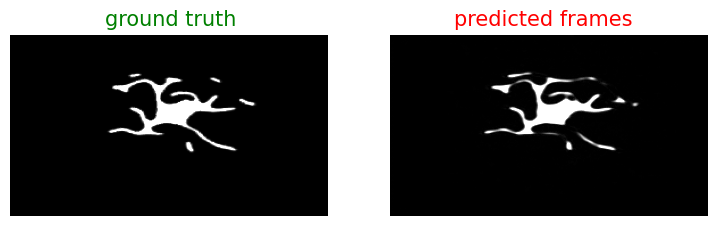

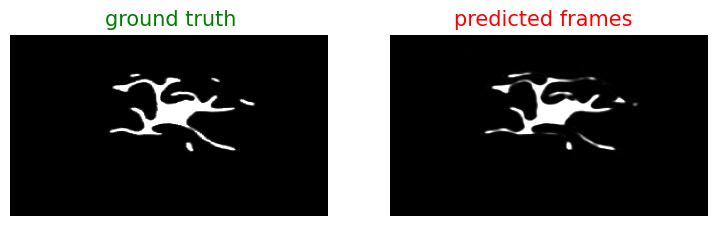

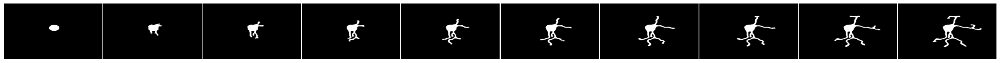

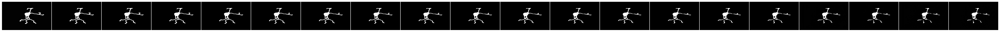

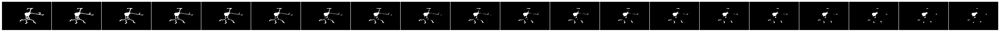

GIF saved as ./prediction_gif/example_6.gif


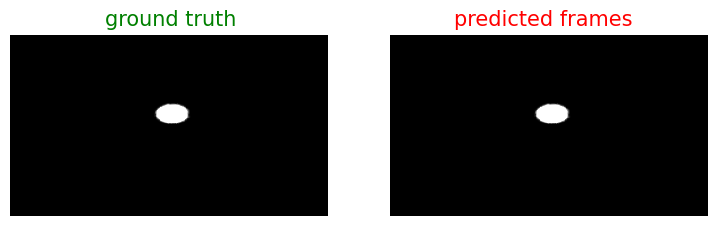

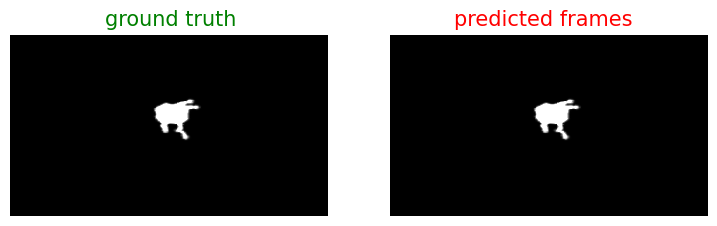

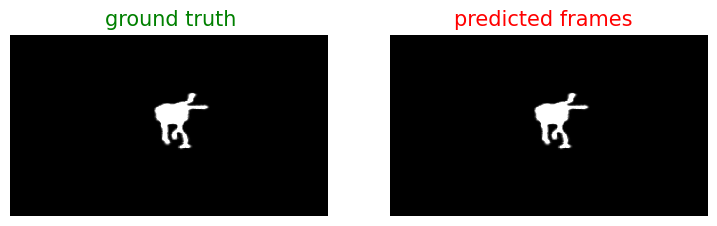

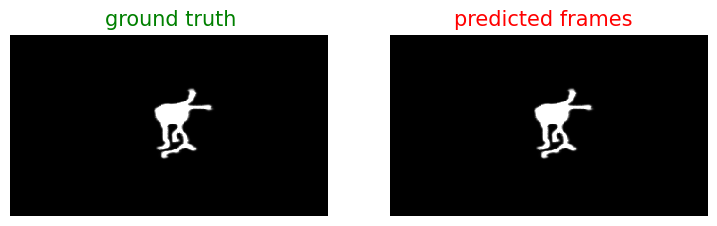

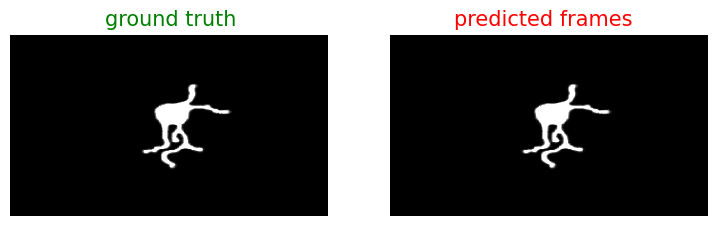

...

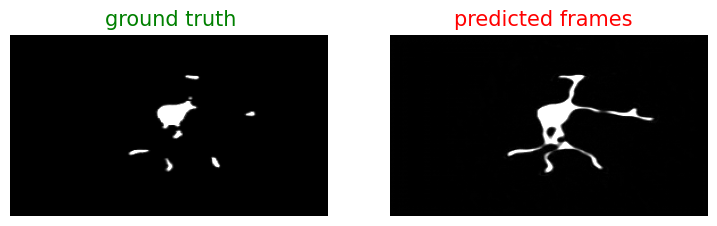

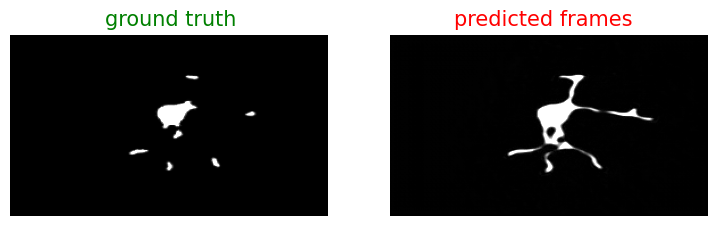

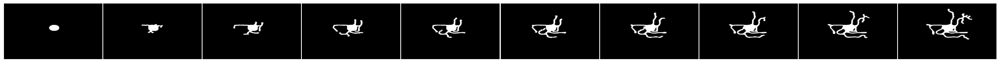

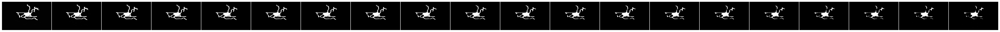

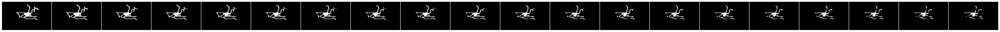

GIF saved as ./prediction_gif/example_7.gif


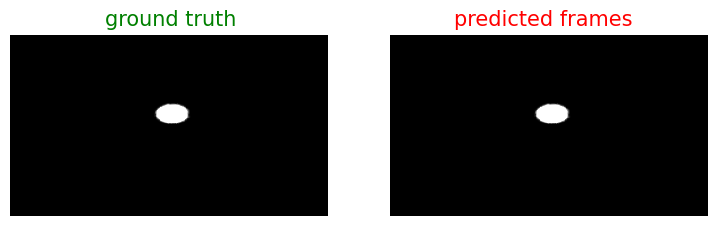

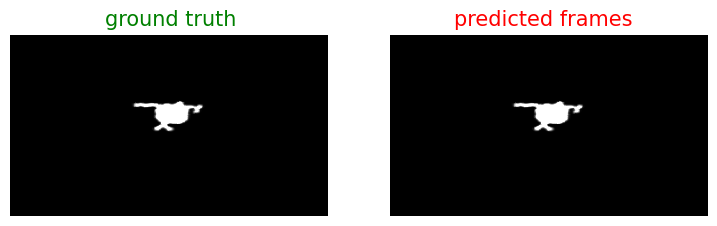

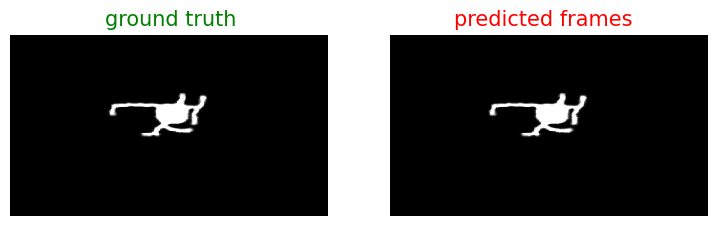

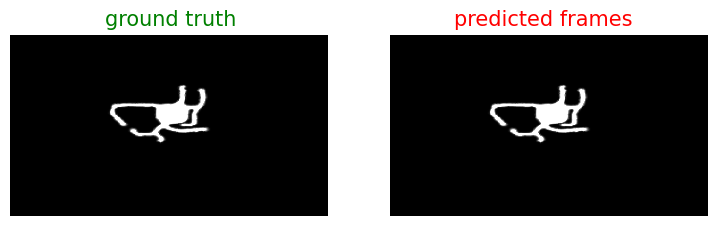

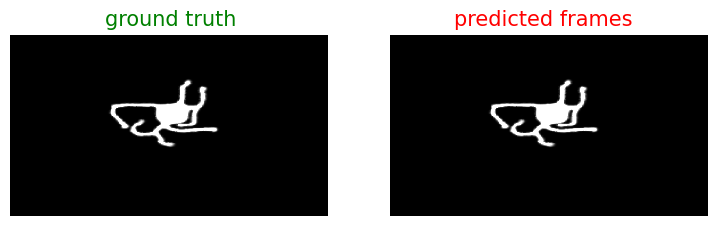

...

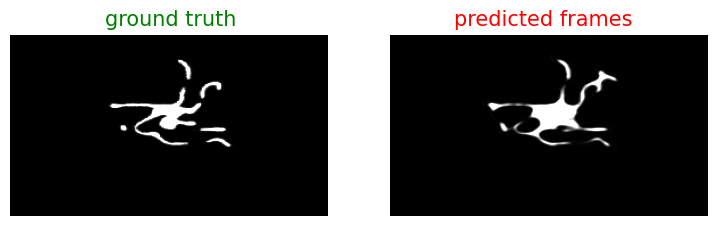

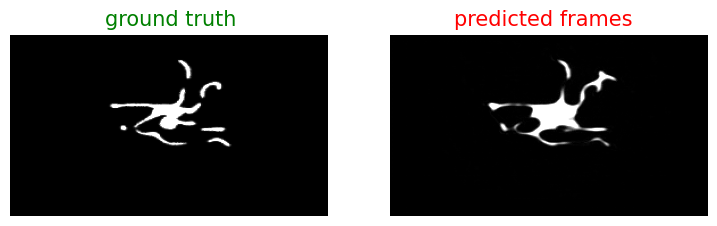

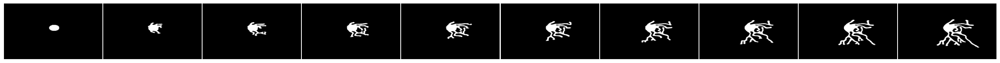

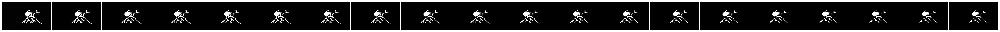

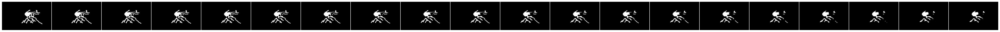

GIF saved as ./prediction_gif/example_8.gif


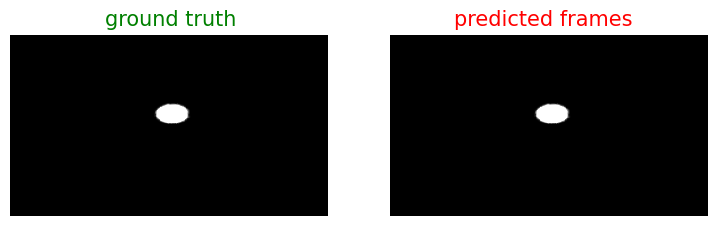

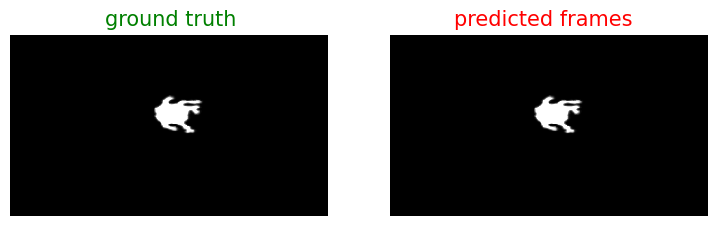

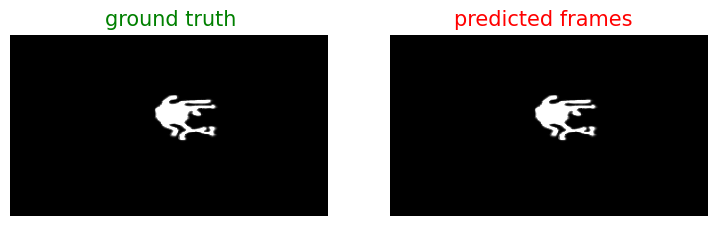

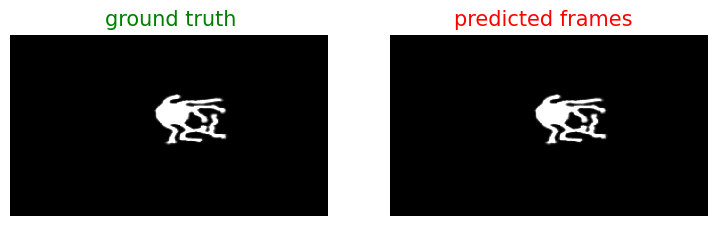

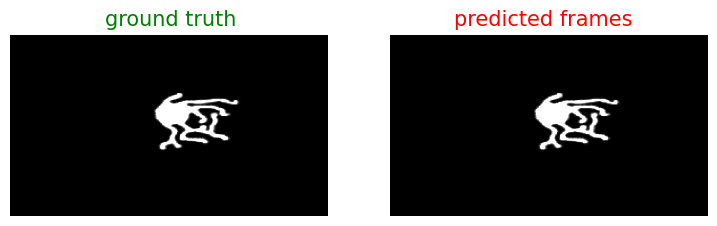

...

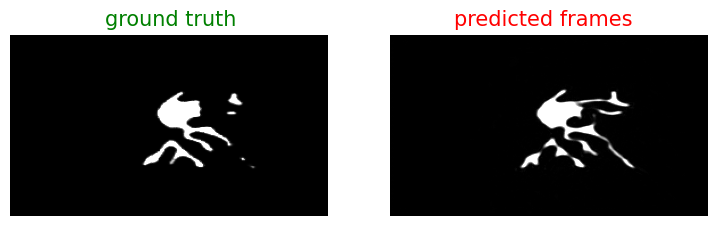

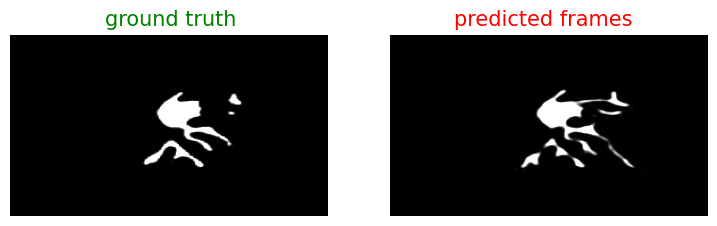

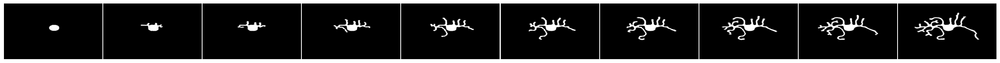

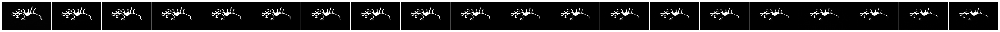

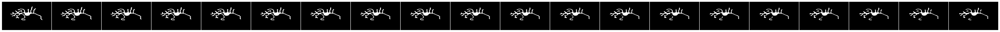

GIF saved as ./prediction_gif/example_9.gif


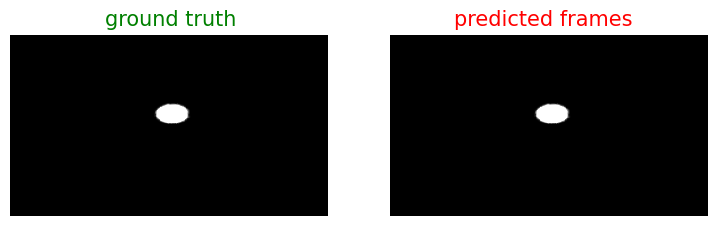

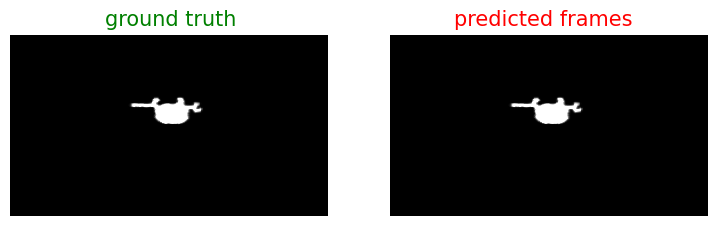

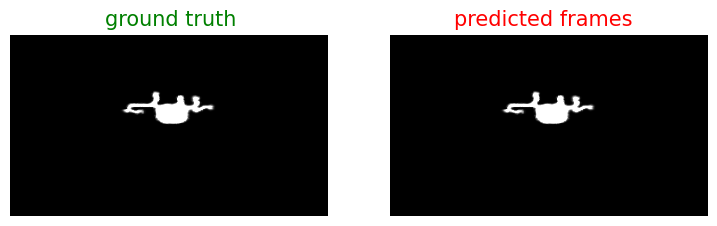

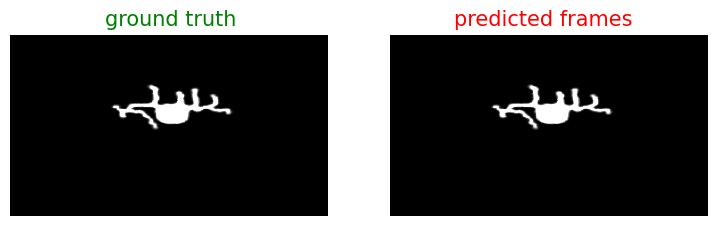

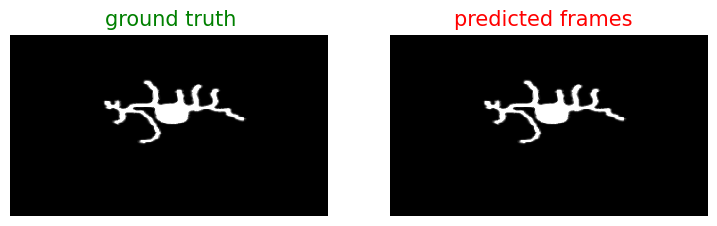

...

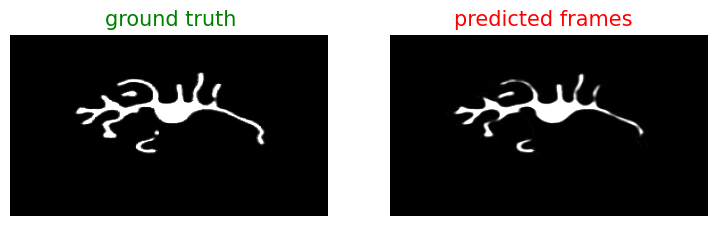

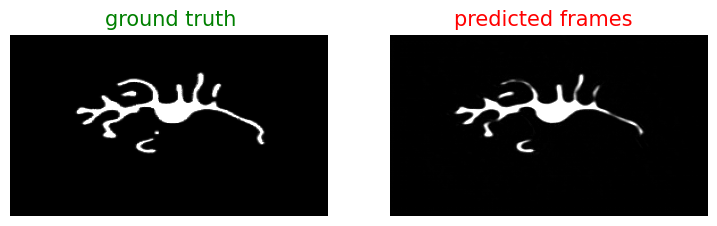

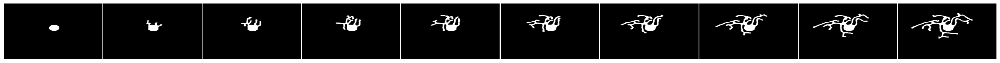

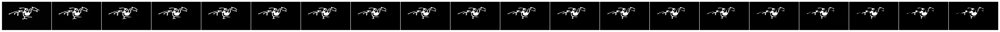

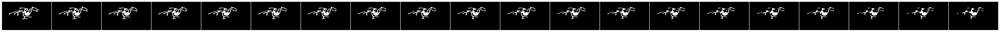

GIF saved as ./prediction_gif/example_10.gif


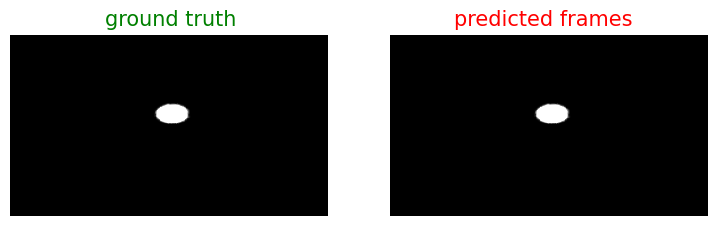

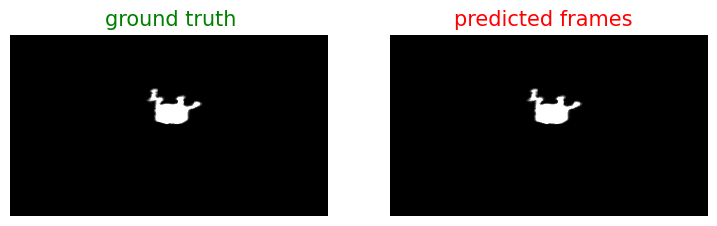

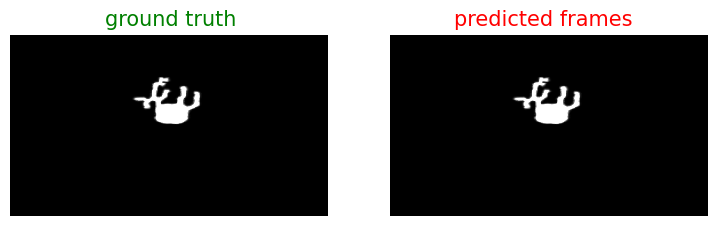

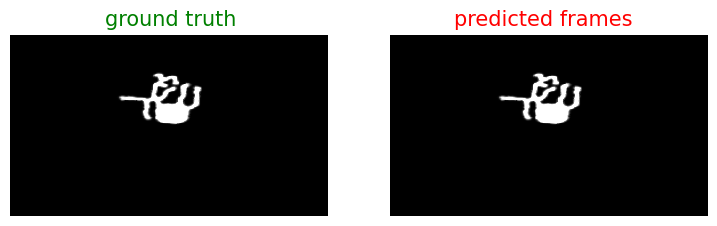

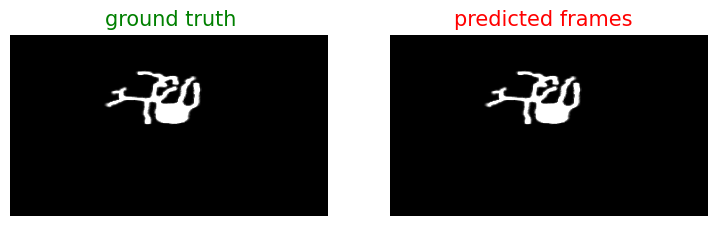

...

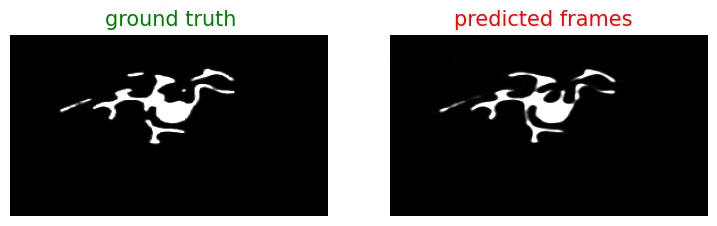

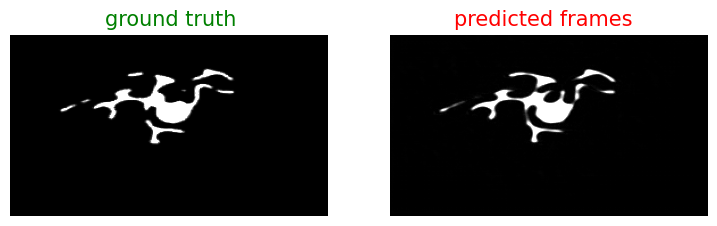

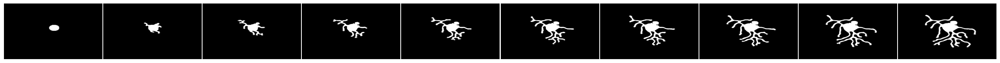

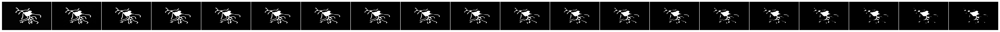

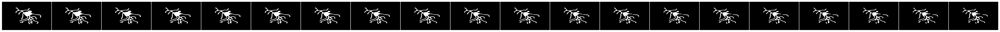

GIF saved as ./prediction_gif/example_11.gif


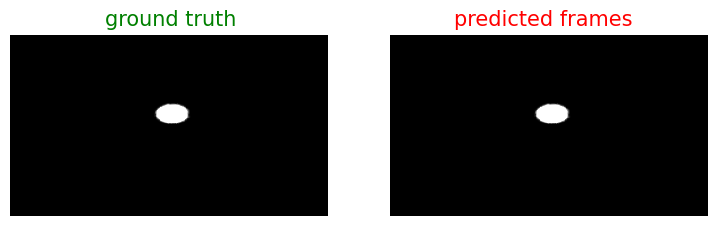

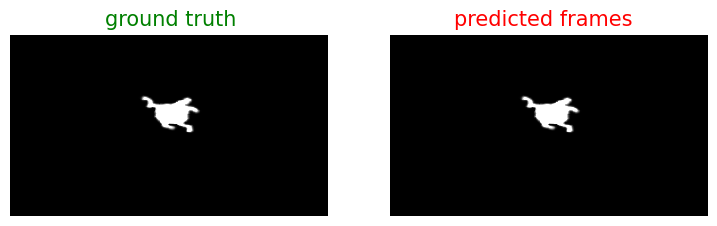

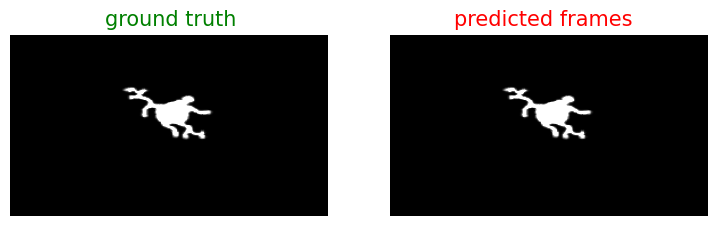

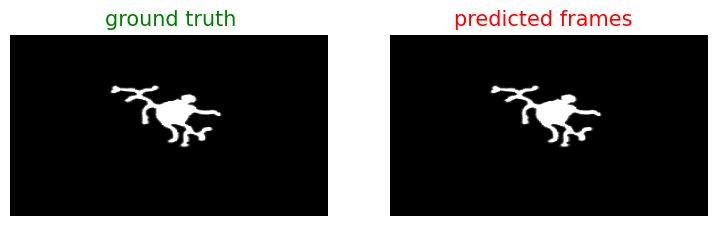

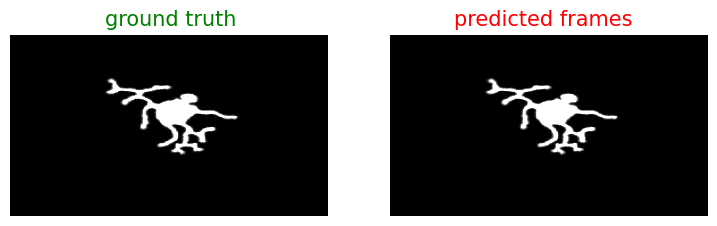

...

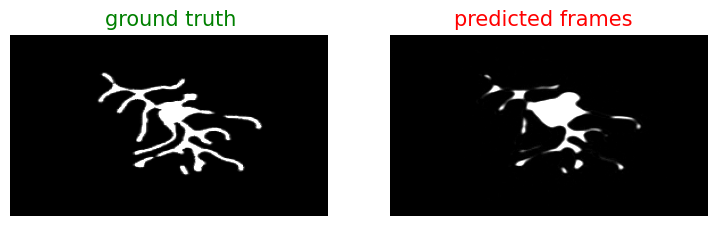

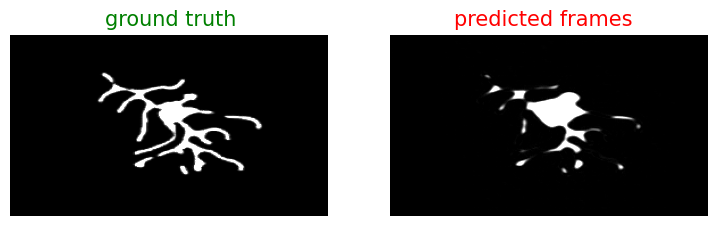

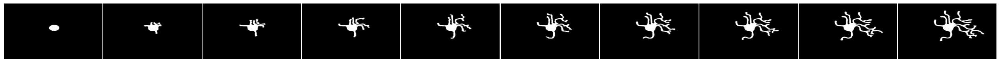

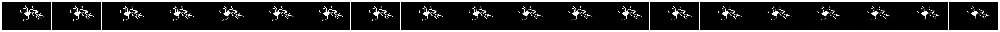

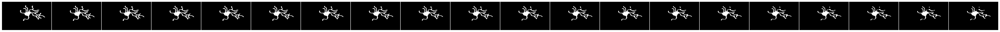

GIF saved as ./prediction_gif/example_12.gif


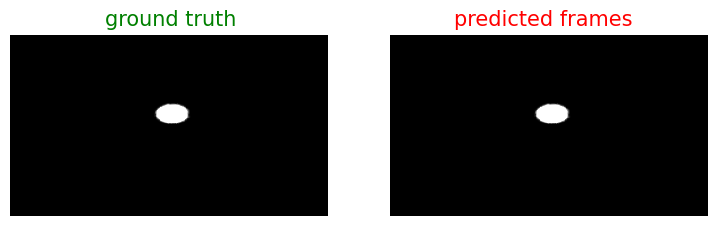

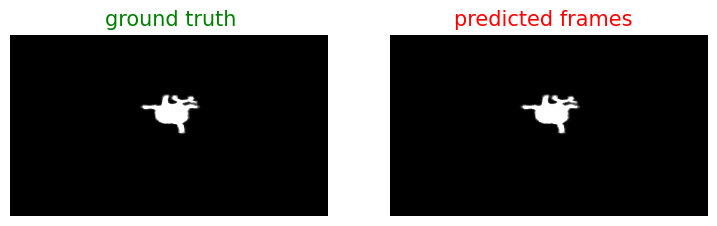

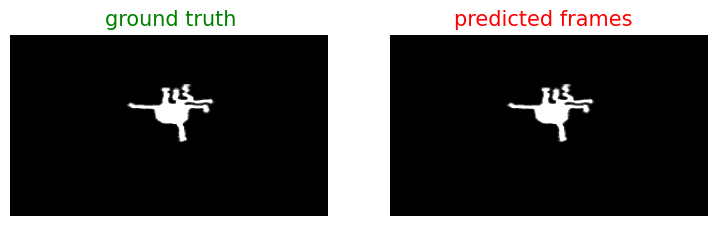

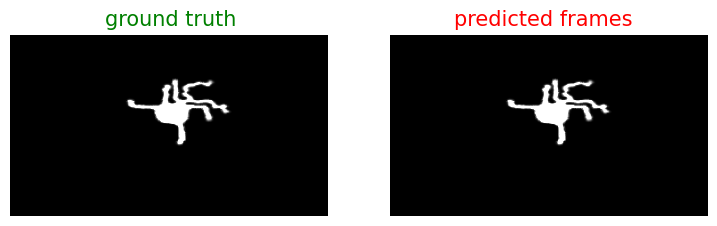

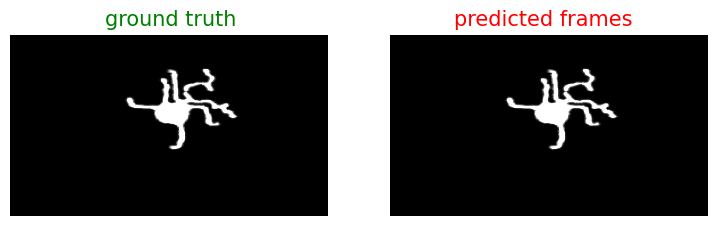

...

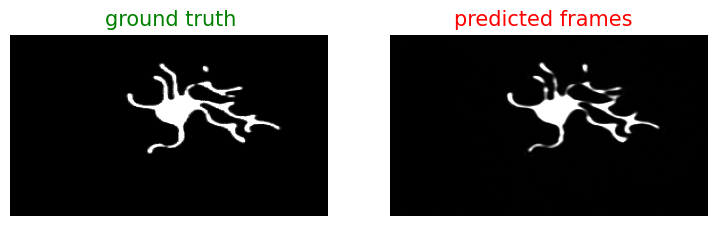

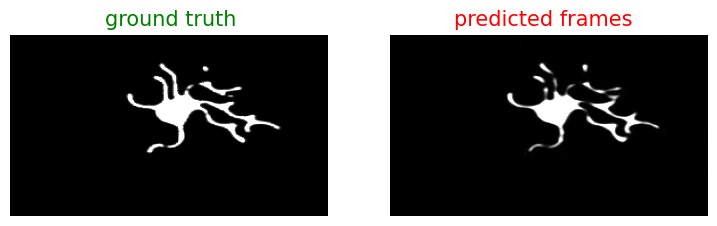

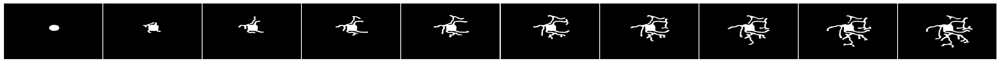

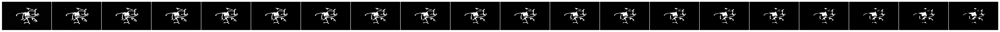

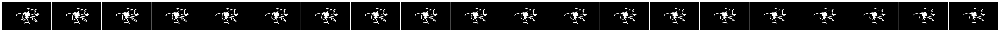

GIF saved as ./prediction_gif/example_13.gif


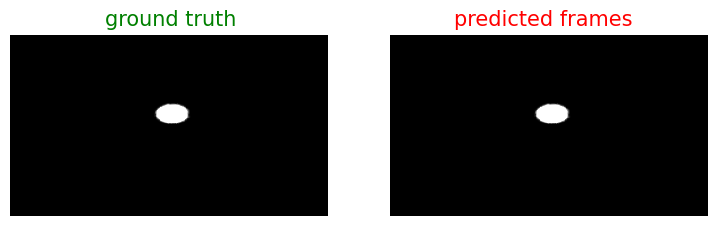

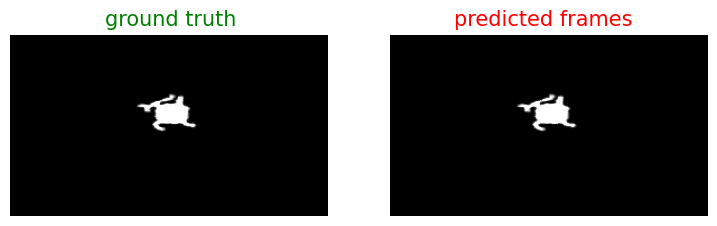

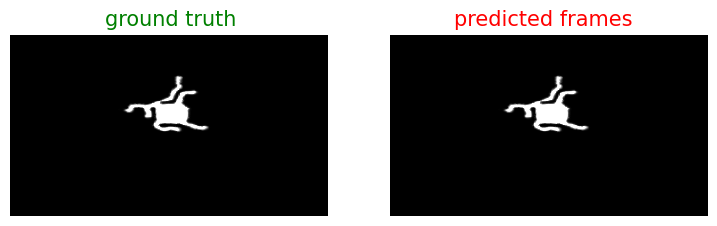

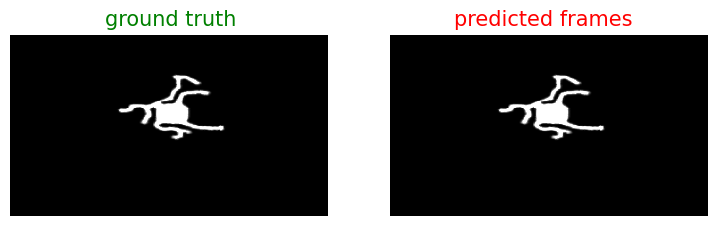

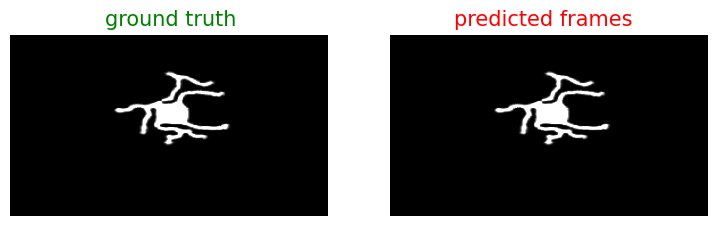

...

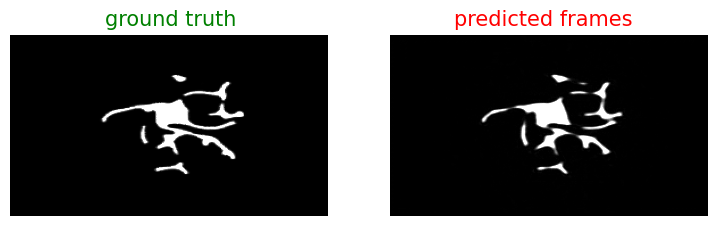

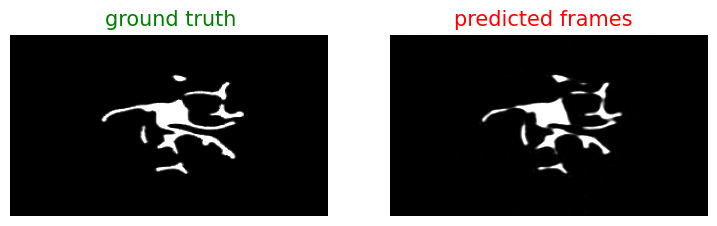

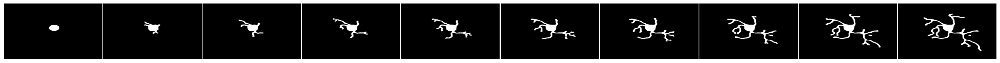

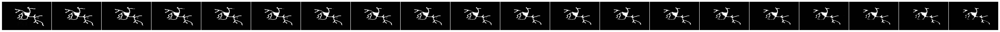

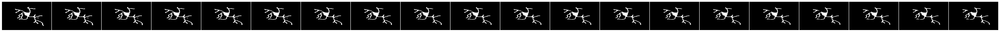

GIF saved as ./prediction_gif/example_14.gif


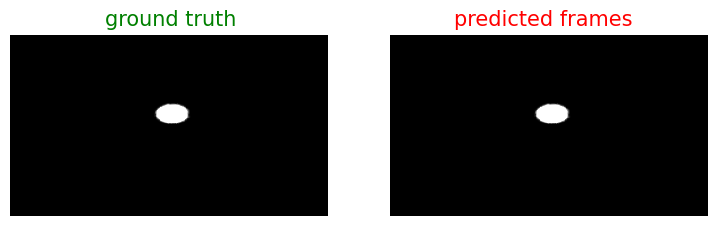

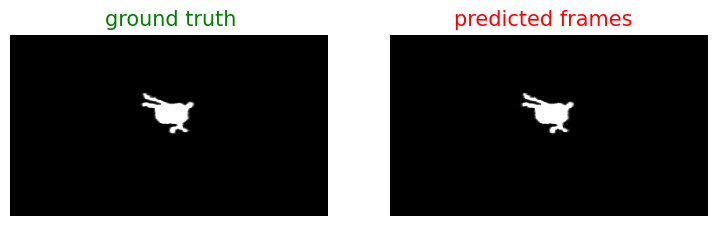

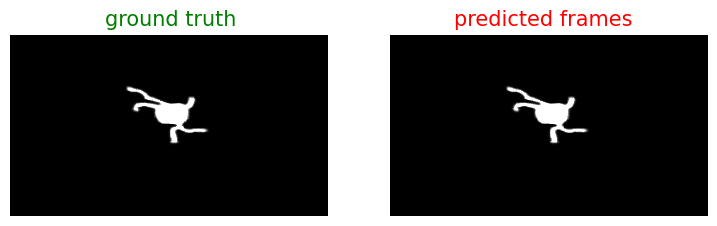

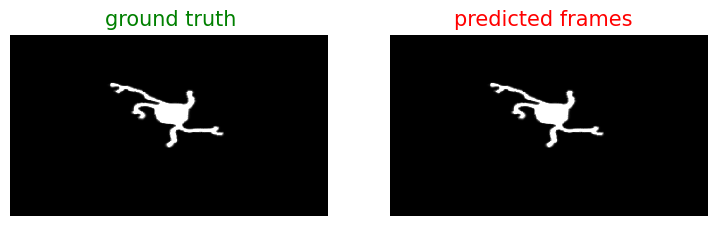

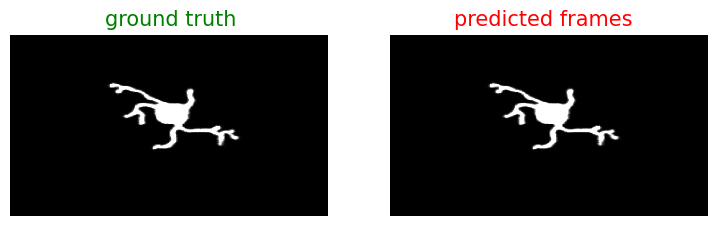

...

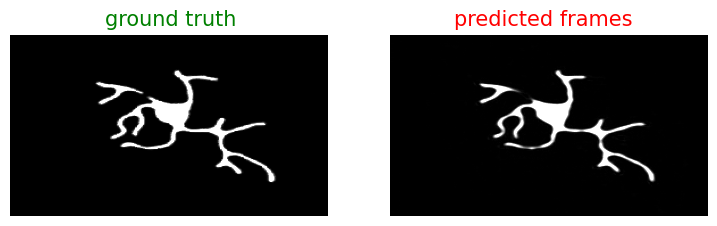

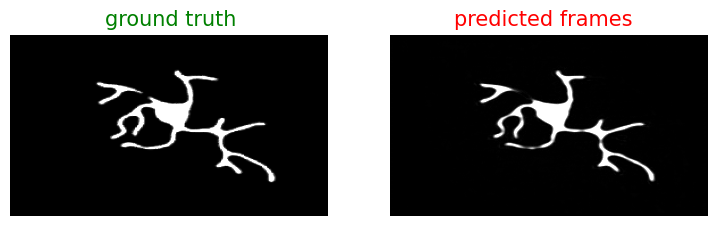

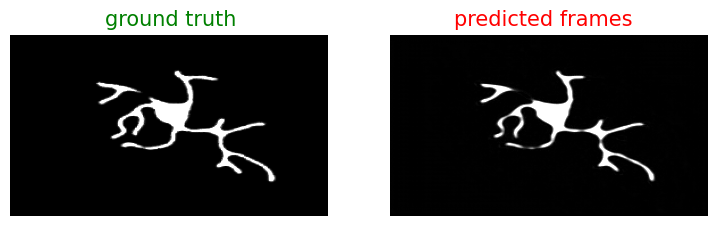

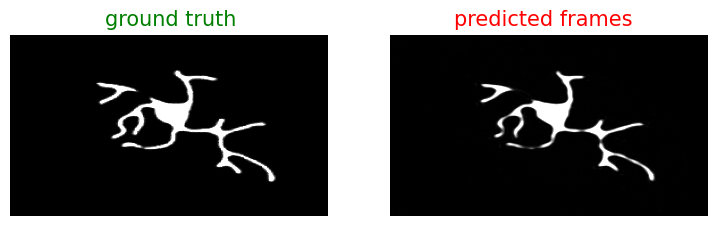

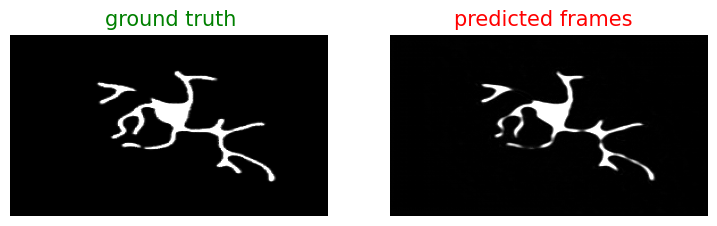

In [29]:
# Import the function for generating GIFs
from openstl.utils import show_video_gif_multiple

for i in range(len(inputs)):
    example_idx = i

    # Modify the output filename to include the random index
    output_gif_filename = f'./prediction_gif/example_{example_idx}.gif'
    show_video_gif_multiple(inputs[example_idx], trues[example_idx], preds[example_idx], use_rgb=False, out_path=output_gif_filename)

    print(f"GIF saved as {output_gif_filename}")